In [3]:
import argparse
import cv2
import sys
import numpy as np
import os
import tqdm
import pickle
import matplotlib.pyplot as plt
# import tensorflow as tf
# print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))
# import pyscikit.ImgKit as kit  
import pandas as pd

# look at the CelebA identity
Filter the images list first

In [4]:
path_identity = 'data/identity_CelebA.txt'
df_iden = pd.read_csv(path_identity, sep=' ')
df_iden.shape

(202598, 2)

In [8]:
df_iden.head(3)

,000001.jpg,2880
0,000002.jpg,2937
1,000003.jpg,8692
2,000004.jpg,5805


In [29]:
dicts = {}
for row_index,row in df_iden.iterrows():
    # row 是一个数组
    # print(row_index,row[0],row[1],'***\n')
    # print(row[0])        # 图片名
    # print(row[1])        # 图片id
    if dicts.get(row[1]) is None:    # id 对应的数组为空
        dicts[row[1]] = [row[0]]    # 把图片名保存到对应id的数组中
    else:
        dicts[row[1]].append(row[0])

# print(dicts)

In [36]:
print('total identity:', len(dicts.keys()))
ths = 30;
filtered_keys = [key for key in dicts.keys() if len(dicts[key]) >= ths]
print('total identity > ths:',len(filtered_keys))
print(filtered_keys)

total identity: 10177
total identity > ths: 2359
[2937, 8692, 5805, 4153, 9040, 6369, 3332, 7081, 1854, 4905, 2464, 6642, 9290, 3670, 1603, 5512, 3272, 4407, 5239, 2079, 4125, 6318, 9177, 4310, 1446, 3896, 8443, 545, 10144, 2879, 6204, 3316, 1499, 1175, 5127, 6145, 5578, 5472, 4876, 7399, 4960, 4262, 6746, 4988, 273, 4323, 1946, 5794, 8833, 3325, 4731, 7256, 6802, 4887, 3705, 7541, 4225, 59, 7222, 5173, 6679, 5609, 2522, 5151, 5787, 8776, 3485, 6568, 4099, 6565, 800, 5311, 1435, 6282, 3055, 4328, 2463, 78, 6844, 5189, 9341, 4258, 7367, 2219, 1472, 5815, 142, 5246, 3376, 4945, 1322, 4811, 1817, 6718, 4664, 4288, 449, 614, 3986, 7524, 4561, 3808, 4686, 7071, 9213, 6936, 1634, 5489, 1204, 6235, 3118, 6440, 6330, 2136, 9027, 6394, 3449, 2150, 3175, 2249, 8939, 1371, 9701, 8514, 3875, 1535, 2239, 6351, 2030, 8469, 4819, 2134, 975, 2965, 1250, 10010, 5611, 9886, 951, 1213, 2026, 4150, 4438, 3034, 4496, 6023, 5784, 6353, 3203, 147, 3501, 9672, 6858, 5193, 7133, 1035, 5329, 1362, 3625, 3029, 2

We take 1st as the enrollment template, and remaining for attack testing

To save time, we only choose randomly 100 ids out to do the experiment

In [53]:
from shutil import copy
for i in range(50):
    for j,key in zip(range(len(filtered_keys)), filtered_keys):
        if j % 40 == 0 :
            print(key)
            imgs_path = os.path.join(r"D:\data\celeba_select", str(key))
            if not os.path.exists(imgs_path):
                os.mkdir(imgs_path)            # 图片的保存路径
                imgs_names = dicts[key]
                for m in range(len(dicts[key])):
                    img = os.path.join(r"D:\data\img_align_celeba\img_align_celeba", dicts[key][m])
                    copy(img, imgs_path)

2937
4960
9341
8939
2063
6191
10095
1686
1368
7826
234
1711
4975
8803
7127
2813
8747
1936
9646
3052
5334
6151
5182
4950
10021
1549
7067
7513
4143
5008
7716
5552
2429
2533
6076
7764
4874
6044
8707
5508
8518
15
7519
8660
7384
5748
1888
953
2034
4580
4474
4740
4302
5354
7429
6219
6999
5539
7824
2937
4960
9341
8939
2063
6191
10095
1686
1368
7826
234
1711
4975
8803
7127
2813
8747
1936
9646
3052
5334
6151
5182
4950
10021
1549
7067
7513
4143
5008
7716
5552
2429
2533
6076
7764
4874
6044
8707
5508
8518
15
7519
8660
7384
5748
1888
953
2034
4580
4474
4740
4302
5354
7429
6219
6999
5539
7824
2937
4960
9341
8939
2063
6191
10095
1686
1368
7826
234
1711
4975
8803
7127
2813
8747
1936
9646
3052
5334
6151
5182
4950
10021
1549
7067
7513
4143
5008
7716
5552
2429
2533
6076
7764
4874
6044
8707
5508
8518
15
7519
8660
7384
5748
1888
953
2034
4580
4474
4740
4302
5354
7429
6219
6999
5539
7824
2937
4960
9341
8939
2063
6191
10095
1686
1368
7826
234
1711
4975
8803
7127
2813
8747
1936
9646
3052
5334
6151
5182
4950
1

5008
7716
5552
2429
2533
6076
7764
4874
6044
8707
5508
8518
15
7519
8660
7384
5748
1888
953
2034
4580
4474
4740
4302
5354
7429
6219
6999
5539
7824
2937
4960
9341
8939
2063
6191
10095
1686
1368
7826
234
1711
4975
8803
7127
2813
8747
1936
9646
3052
5334
6151
5182
4950
10021
1549
7067
7513
4143
5008
7716
5552
2429
2533
6076
7764
4874
6044
8707
5508
8518
15
7519
8660
7384
5748
1888
953
2034
4580
4474
4740
4302
5354
7429
6219
6999
5539
7824
2937
4960
9341
8939
2063
6191
10095
1686
1368
7826
234
1711
4975
8803
7127
2813
8747
1936
9646
3052
5334
6151
5182
4950
10021
1549
7067
7513
4143
5008
7716
5552
2429
2533
6076
7764
4874
6044
8707
5508
8518
15
7519
8660
7384
5748
1888
953
2034
4580
4474
4740
4302
5354
7429
6219
6999
5539
7824
2937
4960
9341
8939
2063
6191
10095
1686
1368
7826
234
1711
4975
8803
7127
2813
8747
1936
9646
3052
5334
6151
5182
4950
10021
1549
7067
7513
4143
5008
7716
5552
2429
2533
6076
7764
4874
6044
8707
5508
8518
15
7519
8660
7384
5748
1888
953
2034
4580
4474
4740
4302
5354

In [32]:
model_prefix = '../models/model-r100-ii/model'
model_epoch = 0
model = face_model.FaceModel(0, model_prefix, model_epoch)

NameError: name 'face_model' is not defined

In [3]:
generated_path = '../../data/lfw_zv_styleGAN_reconstruct/'
with open(os.path.join(generated_path, 'Arnold_Schwarzenegger/Arnold_Schwarzenegger_0015.png.pkl'), 'rb') as f:
    temp1 = pickle.load(f)

In [4]:
temp1 
# x is original image, v is the features, 
# pred_z is the latent code, 
# fake_img is the styleGAN reconstructed image,
# feats = model.get_feature_batch(temp1['fake_img'])
# feats

{'x': array([[[10, 26, 39],
         [10, 26, 41],
         [ 9, 26, 42],
         ...,
         [33, 62, 71],
         [33, 62, 71],
         [33, 62, 71]],
 
        [[ 9, 24, 40],
         [10, 26, 42],
         [10, 27, 43],
         ...,
         [33, 60, 70],
         [32, 60, 70],
         [31, 60, 69]],
 
        [[11, 26, 42],
         [14, 30, 46],
         [16, 32, 49],
         ...,
         [32, 59, 69],
         [31, 59, 69],
         [30, 59, 68]],
 
        ...,
 
        [[59, 62, 60],
         [57, 60, 58],
         [55, 58, 56],
         ...,
         [11, 15, 16],
         [12, 15, 16],
         [14, 16, 16]],
 
        [[65, 68, 66],
         [63, 66, 64],
         [60, 63, 61],
         ...,
         [12, 16, 17],
         [13, 16, 17],
         [14, 16, 16]],
 
        [[63, 67, 62],
         [61, 63, 60],
         [58, 59, 57],
         ...,
         [13, 15, 16],
         [14, 16, 17],
         [14, 16, 16]]], dtype=uint8),
 'v': [array([[-1.50487339e-02,  7.83

# extract feat

In [ ]:
image_base_path = '../../data/lfw_zv_styleGAN_reconstruct/'
feat_base_path = '../../data/lfw_zv_styleGAN_reconstruct_feat/'
# feat_base_path = '/media/xingbo/Storage/Text2AnimeFace/asset_results/stylegan2_celeba_sample_pkl_f2f_zv'
all_files = os.listdir(path=image_base_path)

embeddings = []
labels = []
for subdir in tqdm.tqdm(all_files):
    all_sub_files = os.listdir(path=os.path.join(image_base_path,subdir))
    for subfile in all_sub_files:
        with open(os.path.join(image_base_path,subdir, subfile), 'rb') as f:
            pkl_content = pickle.load(f)
            feats = model.get_feature_batch(pkl_content['fake_img'])
            if not os.path.exists(os.path.join(feat_base_path, subdir)):
                os.mkdir(os.path.join(feat_base_path, subdir))
            with open(os.path.join(feat_base_path, subdir,subfile), 'wb') as f3:
                pickle.dump({'x':  pkl_content['x'],'v':  pkl_content['v'], 'pred_z': pkl_content['pred_z'],'fake_img':pkl_content['fake_img'],'pre_img':feats[0]}, f3)
            

#         img = cv2.imread(os.path.join(image_base_path,subdir,subfile)
# #         img = model.get_input(img)
#         if img is not None:
#             feats = model.get_feature_batch(img)
#             with open(os.path.join(feat_base_path, 'v_lfw_'+subdir+'_'+subfile+'.pkl'), 'wb') as f2:
#                 pickle.dump({'x': img, 'v': feats}, f2)


# attack imposter score

In [3]:
def euc_sim(a,b):
    return 1 - np.linalg.norm(a - b)/(np.linalg.norm(a) + np.linalg.norm(b) )

In [71]:
feat_base_path = '../../data/lfw_zv_styleGAN_reconstruct_feat/'
all_files = os.listdir(path=feat_base_path)
imp_scores = []
successimgpair=[]
failimgpair=[]
cnnt =1
for subdir in tqdm.tqdm(all_files):
    all_sub_files = os.listdir(path=os.path.join(feat_base_path,subdir))
    for subfile in all_sub_files:
        with open(os.path.join(feat_base_path,subdir, subfile), 'rb') as f:
            pkl_content = pickle.load(f)
            imp_score = euc_sim(pkl_content['v'],pkl_content['pre_img'])
            imp_scores.append(imp_score)
            if imp_score >= 0.366:#FAR1000
                successimgpair.append({'fake_img':pkl_content['fake_img'],'bona':pkl_content['x']})
            else:
                if cnnt < 1000:
                    failimgpair.append({'fake_img':pkl_content['fake_img'],'bona':pkl_content['x']})
                cnnt = cnnt + 1
# pickle.dump({'x':  pkl_content['x'],'v':  pkl_content['v'], 
# 'pred_z': pkl_content['pred_z'],'fake_img':pkl_content['fake_img'],'pre_img':feats[0]}, f3)

100%|██████████| 5749/5749 [01:32<00:00, 62.34it/s]


In [72]:
len(successimgpair)

961

In [76]:
batch1 = []
batch2 = []
for i in range(41,51):
    batch1.append(successimgpair[i]['fake_img'][0])
    img = cv2.cvtColor(successimgpair[i]['bona'], cv2.COLOR_BGR2RGB)# attention!!!!!!!!!
    batch2.append(img)

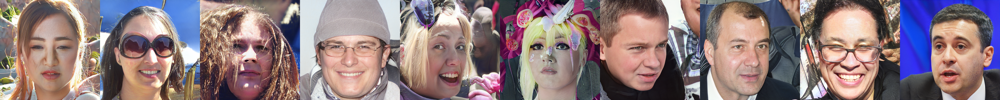

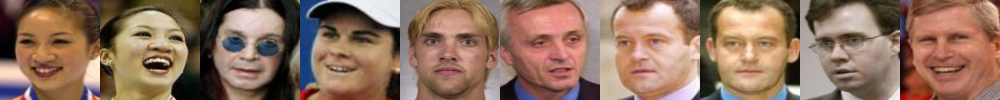

In [77]:
output = kit.displayImages(batch1,rows=1,cols=10,img_size=(1024,1024))
output.save('lfw_reconstr_success_fake_above036_3.png')
output = kit.displayImages(batch2,rows=1,cols=10,img_size=(160,160))
output.save('lfw_reconstr_success_bonafide_above036_3.png')

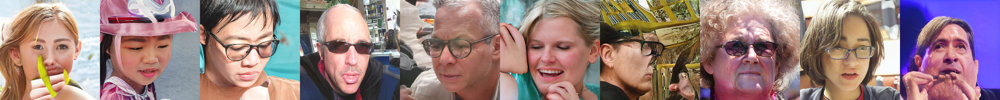

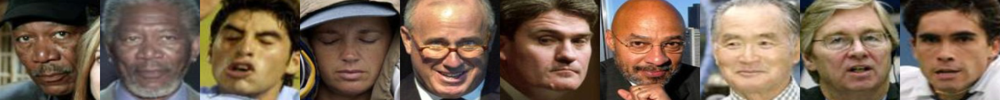

In [66]:
batch1 = []
batch2 = []
for i in range(1,11):
    batch1.append(failimgpair[i]['fake_img'][0])
    img = cv2.cvtColor(failimgpair[i]['bona'], cv2.COLOR_BGR2RGB)# attention!!!!!!!!!
    batch2.append(img)
output = kit.displayImages(batch1,rows=1,cols=10,img_size=(1024,1024))
output.save('lfw_reconstr_fail_fake_above041_2.png')
output = kit.displayImages(batch2,rows=1,cols=10,img_size=(160,160))
output.save('lfw_reconstr_fail_bonafide_above041_2.png')

In [4]:
imp_scores = np.array(imp_scores)
print(np.sum(np.array(imp_scores)>0.4))
# imp_scores[imp_scores>0.4]

136


In [ ]:
# ! wget http://vis-www.cs.umass.edu/lfw/pairs.txt

In [5]:
def loadPairs(pairsFname):
#     print("  + Reading pairs.")
    pairs = []
    with open(pairsFname, 'r') as f:
        for line in f.readlines()[1:]:
            pair = line.strip().split()
            pairs.append(pair)
    assert(len(pairs) == 6000)
    return np.array(pairs)


In [9]:
feat_base_path = '../../data/lfw_zv_styleGAN_reconstruct_feat/'

pairs = loadPairs('pairs.txt')
normal_gen_scores = []
normal_imp_scores = []
attack_imp_scores = []
for pair in tqdm.tqdm(pairs):
    if len(pair)==3: # mated
#         print(pair)
        file1 = os.path.join(feat_base_path,pair[0],pair[0]+'_{:0>4d}.png.pkl'.format(int(pair[1])))
        file2 = os.path.join(feat_base_path,pair[0],pair[0]+'_{:0>4d}.png.pkl'.format(int(pair[2])))
        with open(file1, 'rb') as f:
            pkl_content1 = pickle.load(f)
        with open(file2, 'rb') as f:
            pkl_content2 = pickle.load(f)
        score = euc_sim(np.array(pkl_content1['v']),np.array(pkl_content2['v']))
        normal_gen_scores.append(score)
        
#         here we compute the imposter attack score by GAN
        score1 = euc_sim(np.array(pkl_content1['v']),np.array(pkl_content1['pre_img']))
        score2 = euc_sim(np.array(pkl_content2['v']),np.array(pkl_content2['pre_img']))
        score3 = euc_sim(np.array(pkl_content1['v']),np.array(pkl_content2['pre_img']))
#         attack_imp_scores.append(score1)
#         attack_imp_scores.append(score2)
        attack_imp_scores.append(score3)

    if len(pair) ==4:
        file1 = os.path.join(feat_base_path,pair[0],pair[0]+'_{:0>4d}.png.pkl'.format(int(pair[1])))
        file2 = os.path.join(feat_base_path,pair[2],pair[2]+'_{:0>4d}.png.pkl'.format(int(pair[3])))
        with open(file1, 'rb') as f:
            pkl_content1 = pickle.load(f)
        with open(file2, 'rb') as f:
            pkl_content2 = pickle.load(f)
        score = euc_sim(np.array(pkl_content1['v']),np.array(pkl_content2['v']))
        normal_imp_scores.append(score)
    

<ipython-input-5-51417c55e026>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return np.array(pairs)
100%|██████████| 6000/6000 [00:04<00:00, 1208.01it/s]


/home/charles/miniconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/charles/miniconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/charles/miniconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibili

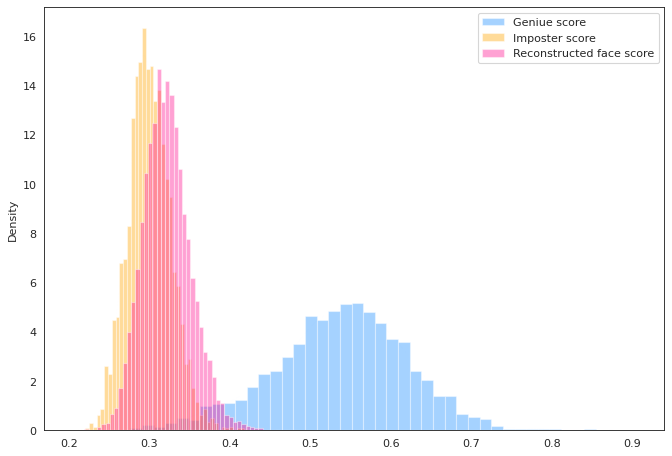

In [14]:
import seaborn as sns
from pyeer.eer_info import get_eer_stats
from pyeer.report import generate_eer_report, export_error_rates
from pyeer.plot import plot_eer_stats

sns.set_style("white")

# Import data

# Plot
kwargs = dict(hist_kws={'10':.4}, kde_kws={'linewidth':0.001})

plt.figure(figsize=(10,7), dpi= 80)
sns.distplot(normal_gen_scores, color="dodgerblue", label="Geniue score", **kwargs)
sns.distplot(normal_imp_scores, color="orange", label="Imposter score", **kwargs)
sns.distplot(imp_scores, color="deeppink", label="Reconstructed face score", **kwargs)
# plt.xlim(50,75)
plt.legend();
plt.savefig("score_dist_lfw_type1.svg")


/home/charles/miniconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/charles/miniconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/charles/miniconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibili

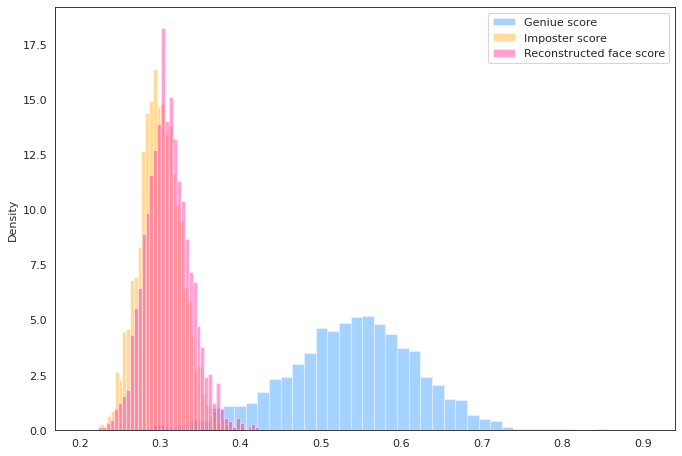

In [12]:
import seaborn as sns
from pyeer.eer_info import get_eer_stats
from pyeer.report import generate_eer_report, export_error_rates
from pyeer.plot import plot_eer_stats

sns.set_style("white")

# Import data

# Plot
kwargs = dict(hist_kws={'alpha':.4}, kde_kws={'linewidth':0.001})

plt.figure(figsize=(10,7), dpi= 80)
sns.distplot(normal_gen_scores, color="dodgerblue", label="Geniue score", **kwargs)
sns.distplot(normal_imp_scores, color="orange", label="Imposter score", **kwargs)
# sns.distplot(imp_scores, color="deeppink", label="Reconstructed face score", **kwargs)
sns.distplot(attack_imp_scores, color="deeppink", label="Reconstructed face score", **kwargs)
# plt.xlim(50,75)
plt.legend();
plt.savefig("score_dist_lfw_type2.svg")


In [11]:
# FMR100 (the lowest FNMR for FMR<=1%)
# FMR1000 (the lowest FNMR for FMR<=0.1%)
# ZeroFMR (the lowest FNMR for FMR=0%)
# ZeroFNMR (the lowest FMR for FNMR=0%)

stats_a = get_eer_stats(normal_gen_scores, normal_imp_scores)

print('the lowest FNMR for FMR<=xxx%')
print(1-stats_a.fmr0,stats_a.fmr0_th)
print(1-stats_a.fmr1000,stats_a.fmr1000_th)
print(1-stats_a.fmr100,stats_a.fmr100_th)
print(1-stats_a.fmr10,stats_a.fmr10_th)

print('the lowest FNMR for FMR<=xxx%')
print(stats_a.fmr0,stats_a.fmr0_th)
print(stats_a.fmr1000,stats_a.fmr1000_th)
print(stats_a.fmr100,stats_a.fmr100_th)
print(stats_a.fmr10,stats_a.fmr10_th)

print('for normal, the lowest FNMR for FMR<=xxx%')
print(sum(normal_gen_scores>stats_a.fmr0_th)/len(normal_gen_scores))
print(sum(normal_gen_scores>stats_a.fmr1000_th)/len(normal_gen_scores))
print(sum(normal_gen_scores>stats_a.fmr100_th)/len(normal_gen_scores))
print(sum(normal_gen_scores>stats_a.fmr10_th)/len(normal_gen_scores))

print('for attack, the lowest FNMR for FMR<=xxx%')
print(sum(imp_scores>stats_a.fmr0_th)/len(attack_imp_scores))
print(sum(imp_scores>stats_a.fmr1000_th)/len(attack_imp_scores))
print(sum(imp_scores>stats_a.fmr100_th)/len(attack_imp_scores))
print(sum(imp_scores>stats_a.fmr10_th)/len(attack_imp_scores))

print('for attack, the lowest FNMR for FMR<=xxx%')
print(sum(attack_imp_scores>stats_a.fmr0_th)/len(attack_imp_scores))
print(sum(attack_imp_scores>stats_a.fmr1000_th)/len(attack_imp_scores))
print(sum(attack_imp_scores>stats_a.fmr100_th)/len(attack_imp_scores))
print(sum(attack_imp_scores>stats_a.fmr10_th)/len(attack_imp_scores))


the lowest FNMR for FMR<=xxx%
0.9176666666666666 0.41829633712768555
0.938 0.4007757306098938
0.974 0.36690598726272583
0.9893333333333333 0.33365392684936523
the lowest FNMR for FMR<=xxx%
0.08233333333333333 0.41829633712768555
0.062 0.4007757306098938
0.026 0.36690598726272583
0.010666666666666666 0.33365392684936523
for normal, the lowest FNMR for FMR<=xxx%
0.9173333333333333
0.9376666666666666
0.9736666666666667
0.9893333333333333
for attack, the lowest FNMR for FMR<=xxx%
0.014666666666666666
0.042666666666666665
0.30333333333333334
1.3823333333333334
for attack, the lowest FNMR for FMR<=xxx%
0.001
0.004666666666666667
0.03133333333333333
0.183


# LFW samples

In [ ]:
generated_path = '../../data/lfw_zv_styleGAN_reconstruct/'
with open(os.path.join(generated_path, 'Arnold_Schwarzenegger/Arnold_Schwarzenegger_0001.png.pkl'), 'rb') as f:
    temp1 = pickle.load(f)

In [ ]:
img = cv2.imread('Aaron_Guiel_0001.png')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

output = kit.displayImages([img, temp1['fake_img'][0]],rows=1,cols=10)


In [2]:
# temp1 
# x is original image, v is the features, 
# pred_z is the latent code, 
# fake_img is the styleGAN reconstructed image,
# feats = model.get_feature_batch(temp1['fake_img'])
# feats
feat_base_path = '../../data/lfw_zv_styleGAN_reconstruct_feat/'
all_files = os.listdir(path=feat_base_path)
orig_imgs = []
reconstruct_imgs = []

for subdir in tqdm.tqdm(all_files):
    all_sub_files = os.listdir(path=os.path.join(feat_base_path,subdir))
    with open(os.path.join(feat_base_path, subdir,subdir + '_0001.png.pkl'), 'rb') as f:
        pkl_content = pickle.load(f)
        img = cv2.cvtColor(pkl_content['x'], cv2.COLOR_BGR2RGB)
        orig_imgs.append(img)
        re_img = cv2.resize(pkl_content['fake_img'][0], dsize=(160, 160), interpolation=cv2.INTER_CUBIC)
        reconstruct_imgs.append(re_img)
reconstruct_imgs = np.array(reconstruct_imgs)
orig_imgs = np.array(orig_imgs)

 13%|█▎        | 771/5749 [00:06<00:41, 121.23it/s]


KeyboardInterrupt: 

In [ ]:
cnt = 10
perm = np.random.permutation(2000)

output = kit.displayImages(orig_imgs[perm[:cnt]],rows=1,cols=10,img_size=(160,160))
output.save('lfw_orig_5.png')
output = kit.displayImages(reconstruct_imgs[perm[:cnt]],rows=1,cols=10,img_size=(160,160))
output.save('lfw_recontruct_5.png')

# CelebA samples

In [15]:
image_base_path = '../../data/celeba_zv_styleGAN_reconstruct_1k/'
feat_base_path = '../../data/celeba_zv_styleGAN_reconstruct_feat_1k/'
# feat_base_path = '/media/xingbo/Storage/Text2AnimeFace/asset_results/stylegan2_celeba_sample_pkl_f2f_zv'
all_files = os.listdir(path=image_base_path)
for subdir in tqdm.tqdm(all_files):
    with open(os.path.join(image_base_path, subdir), 'rb') as f:
        pkl_content = pickle.load(f)
        feats = model.get_feature_batch(pkl_content['fake_img'])
        with open(os.path.join(feat_base_path, subdir), 'wb') as f3:
            pickle.dump({'x':  pkl_content['x'],'v':  pkl_content['v'], 'pred_z': pkl_content['pred_z'],'fake_img':pkl_content['fake_img'],'pre_img':feats[0]}, f3)

  0%|          | 0/11800 [00:00<?, ?it/s]


NameError: name 'model' is not defined

In [16]:
def euc_sim(a,b):
    return 1 - np.linalg.norm(a - b)/(np.linalg.norm(a) + np.linalg.norm(b) )

In [17]:
# temp1 
# x is original image, v is the features, 
# pred_z is the latent code, 
# fake_img is the styleGAN reconstructed image,
# feats = model.get_feature_batch(temp1['fake_img'])
# feats
feat_base_path = '../../data/celeba_zv_styleGAN_reconstruct_feat_1k/'
all_files = np.array(os.listdir(path=feat_base_path))
orig_imgs = []
reconstruct_imgs = []
# cnt = 200
# perm = np.random.permutation(20000)
# all_files = all_files[perm[:cnt]]
imposter_scores = []
for subdir in tqdm.tqdm(all_files):
    with open(os.path.join(feat_base_path, subdir), 'rb') as f:
        pkl_content = pickle.load(f)
#         img = cv2.resize(pkl_content['x'], dsize=(256, 256), interpolation=cv2.INTER_CUBIC)
#         orig_imgs.append(img)
#         re_img = cv2.resize(pkl_content['fake_img'][0], dsize=(256, 256), interpolation=cv2.INTER_CUBIC)
#         reconstruct_imgs.append(re_img)
        imp_score = euc_sim(pkl_content['v'],pkl_content['pre_img'])
        imposter_scores.append(imp_score)
        
reconstruct_imgs = np.array(reconstruct_imgs)
orig_imgs = np.array(orig_imgs)

100%|██████████| 11800/11800 [01:23<00:00, 141.15it/s]


In [18]:
filetxt = '/media/charles/SSD/sourcecode/f2f/data/identity_CelebA.txt'
def loadCelebAdict(filetxt):
    dicts = {}
    with open(filetxt, 'r') as f:
        for line in tqdm.tqdm(f.readlines()):
            pair = line.strip().split()
            filename = pair[0]
            ids = int(pair[1])
            if dicts.get(ids) is None:
                dicts[ids] = [filename]
            else:
                dicts[ids].append(filename)
    return dicts

In [19]:
dicts = loadCelebAdict(filetxt)
thrs = 20
new_dicts = {}
for key in dicts.keys():
    if len(dicts[key]) >= thrs:
        new_dicts[key] = dicts[key][:5]
print(len(new_dicts))

100%|██████████| 202599/202599 [00:00<00:00, 1642359.62it/s]

6348


In [20]:
with open('../../data/newdict.pkl', 'rb') as f:
    mynew_dict = pickle.load(f)
# mynew_dict[8231]
# allkeys[5]
new_dict = mynew_dict['newdict']

In [22]:
normal_gen_scores = []
normal_imp_scores = []
attack_imp_scores = []
feat_base_path = '../../data/celeba_zv_styleGAN_reconstruct_feat_1k/'

allkeys = [ky for ky in new_dicts.keys()]
def findother(allkeys,key):
    rndkey = allkeys[np.random.randint(len(allkeys))]
    if rndkey == key:
        return findother(allkeys,key)
    else:
        return rndkey

for key in new_dicts.keys():
    filelist = new_dicts[key]
    anotherkey = findother(allkeys,key)
#     print(anotherkey)
    another =new_dicts[anotherkey][0]
    file1 = os.path.join(feat_base_path,filelist[0])
    file2 = os.path.join(feat_base_path,filelist[1])
    file3 = os.path.join(feat_base_path,another)# find a imposter randomly 
#     print(file3)
    if not os.path.exists(file1) or not os.path.exists(file2):
#         print(file3,'is none')
        continue
    with open(file1, 'rb') as f:
        pkl_content1 = pickle.load(f)
    with open(file2, 'rb') as f:
        pkl_content2 = pickle.load(f)

    score = euc_sim(np.array(pkl_content1['v']),np.array(pkl_content2['v']))
    normal_gen_scores.append(score)
    
    score = euc_sim(np.array(pkl_content1['v']),np.array(pkl_content1['pre_img']))
    attack_imp_scores.append(score)
    
    score = euc_sim(np.array(pkl_content2['v']),np.array(pkl_content2['pre_img']))
    attack_imp_scores.append(score)
    
    if os.path.exists(file3):
        with open(file3, 'rb') as f:
            pkl_content3 = pickle.load(f)    
            score = euc_sim(np.array(pkl_content1['v']),np.array(pkl_content3['v']))
            normal_imp_scores.append(score)
    
    
    

    # cnt = 200
# perm = np.random.permutation(20000)
# all_files = all_files[perm[:cnt]]



/home/charles/miniconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/charles/miniconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/charles/miniconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibili

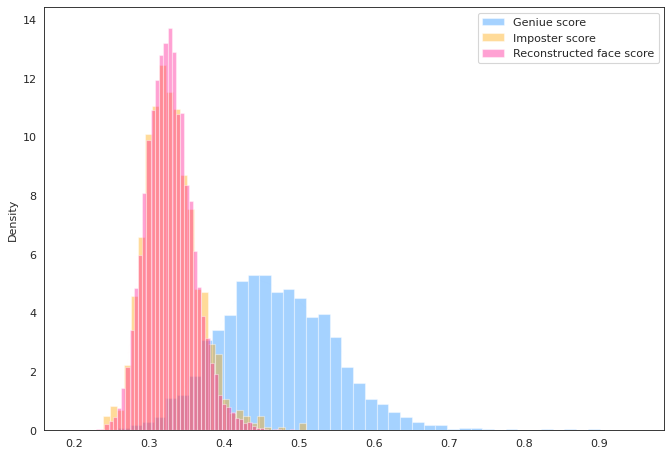

In [23]:
import seaborn as sns
from pyeer.eer_info import get_eer_stats
from pyeer.report import generate_eer_report, export_error_rates
from pyeer.plot import plot_eer_stats

sns.set_style("white")

# Import data

# Plot
kwargs = dict(hist_kws={'alpha':.4}, kde_kws={'linewidth':0.001})

plt.figure(figsize=(10,7), dpi= 80)
sns.distplot(normal_gen_scores, color="dodgerblue", label="Geniue score", **kwargs)
sns.distplot(normal_imp_scores, color="orange", label="Imposter score", **kwargs)
sns.distplot(imposter_scores, color="deeppink", label="Reconstructed face score", **kwargs)
# sns.distplot(attack_imp_scores, color="deeppink", label="Reconstructed face score", **kwargs)
# plt.xlim(50,75)
plt.legend();
plt.savefig("score_dist_celeba_type1.svg")


/home/charles/miniconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/charles/miniconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/charles/miniconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibili

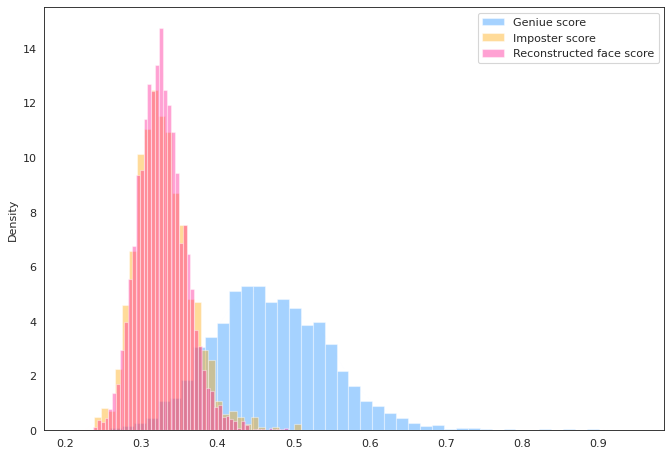

In [24]:
import seaborn as sns
from pyeer.eer_info import get_eer_stats
from pyeer.report import generate_eer_report, export_error_rates
from pyeer.plot import plot_eer_stats

sns.set_style("white")

# Import data

# Plot
kwargs = dict(hist_kws={'alpha':.4}, kde_kws={'linewidth':0.001})

plt.figure(figsize=(10,7), dpi= 80)
sns.distplot(normal_gen_scores, color="dodgerblue", label="Geniue score", **kwargs)
sns.distplot(normal_imp_scores, color="orange", label="Imposter score", **kwargs)
# sns.distplot(imposter_scores, color="deeppink", label="Reconstructed face score", **kwargs)
sns.distplot(attack_imp_scores, color="deeppink", label="Reconstructed face score", **kwargs)
# plt.xlim(50,75)
plt.legend();
plt.savefig("score_dist_celeba_type2.svg")


In [25]:
# FMR100 (the lowest FNMR for FMR<=1%)
# FMR1000 (the lowest FNMR for FMR<=0.1%)
# ZeroFMR (the lowest FNMR for FMR=0%)
# ZeroFNMR (the lowest FMR for FNMR=0%)

stats_a = get_eer_stats(normal_gen_scores, normal_imp_scores)

print('the lowest FNMR for FMR<=xxx%')
print(1-stats_a.fmr0,stats_a.fmr0_th)
print(1-stats_a.fmr1000,stats_a.fmr1000_th)
print(1-stats_a.fmr100,stats_a.fmr100_th)
print(1-stats_a.fmr10,stats_a.fmr10_th)

print('the lowest FNMR for FMR<=xxx%')
print(stats_a.fmr0,stats_a.fmr0_th)
print(stats_a.fmr1000,stats_a.fmr1000_th)
print(stats_a.fmr100,stats_a.fmr100_th)
print(stats_a.fmr10,stats_a.fmr10_th)

print('for normal, the lowest FNMR for FMR<=xxx%')
print(sum(normal_gen_scores>stats_a.fmr0_th)/len(normal_gen_scores))
print(sum(normal_gen_scores>stats_a.fmr1000_th)/len(normal_gen_scores))
print(sum(normal_gen_scores>stats_a.fmr100_th)/len(normal_gen_scores))
print(sum(normal_gen_scores>stats_a.fmr10_th)/len(normal_gen_scores))

print('for attack, the lowest FNMR for FMR<=xxx%')
print(sum(imposter_scores>stats_a.fmr0_th)/len(attack_imp_scores))
print(sum(imposter_scores>stats_a.fmr1000_th)/len(attack_imp_scores))
print(sum(imposter_scores>stats_a.fmr100_th)/len(attack_imp_scores))
print(sum(imposter_scores>stats_a.fmr10_th)/len(attack_imp_scores))

print('for attack, the lowest FNMR for FMR<=xxx%')
print(sum(attack_imp_scores>stats_a.fmr0_th)/len(attack_imp_scores))
print(sum(attack_imp_scores>stats_a.fmr1000_th)/len(attack_imp_scores))
print(sum(attack_imp_scores>stats_a.fmr100_th)/len(attack_imp_scores))
print(sum(attack_imp_scores>stats_a.fmr10_th)/len(attack_imp_scores))


the lowest FNMR for FMR<=xxx%
0.2932203389830509 0.509588360786438
0.32499999999999996 0.5014901757240295
0.6228813559322034 0.4418327212333679
0.8991525423728813 0.375573992729187
the lowest FNMR for FMR<=xxx%
0.7067796610169491 0.509588360786438
0.675 0.5014901757240295
0.3771186440677966 0.4418327212333679
0.10084745762711865 0.375573992729187
for normal, the lowest FNMR for FMR<=xxx%
0.29279661016949154
0.32457627118644067
0.622457627118644
0.898728813559322
for attack, the lowest FNMR for FMR<=xxx%
0.0
0.0
0.004661016949152543
0.17245762711864407
for attack, the lowest FNMR for FMR<=xxx%
0.0
0.0
0.00211864406779661
0.06377118644067796


In [ ]:
cnt = 10
perm = np.random.permutation(20000)

output = kit.displayImages(orig_imgs[perm[:cnt]],rows=1,cols=10,img_size=(256,256))
output.save('celeba_orig_5.png')
output = kit.displayImages(reconstruct_imgs[perm[:cnt]],rows=1,cols=10,img_size=(256,256))
output.save('celeba_recontruct_5.png')

In [29]:
import numpy as np
np.random.randint(10)

0

In [ ]:
# with open(os.path.join(feat_base_path, 'lfw_v_lfw_Alvaro_Uribe_Alvaro_Uribe_0001.png.pkl'), 'rb') as f:
#     temp1 = pickle.load(f)
# with open(os.path.join(feat_base_path, 'lfw_v_lfw_Alvaro_Uribe_Alvaro_Uribe_0002.png.pkl'), 'rb') as f:
#     temp2 = pickle.load(f)
# with open(os.path.join(feat_base_path, 'lfw_v_lfw_Alvaro_Uribe_Alvaro_Uribe_0003.png.pkl'), 'rb') as f:
#     temp3 = pickle.load(f)

# with open(os.path.join(feat_base_path, 'lfw_v_lfw_Alvaro_Uribe_Alvaro_Uribe_0004.png.pkl'), 'rb') as f:
#     temp4 = pickle.load(f)
    
# with open(os.path.join(feat_base_path, 'lfw_v_lfw_Abdoulaye_Wade_Abdoulaye_Wade_0001.png.pkl'), 'rb') as f:
#     temp_imp = pickle.load(f)
    
# print(euc_sim(temp1['orig_feat'],temp1['fake_feat'][0][0]))
# print(euc_sim(temp2['orig_feat'],temp2['fake_feat'][0][0]))
# print(euc_sim(temp3['orig_feat'],temp3['fake_feat'][0][0]))
# print(euc_sim(temp4['orig_feat'],temp4['fake_feat'][0][0]))
# print("******again*********")
# print(euc_sim(temp2['orig_feat'],temp1['fake_feat'][0][0]))
# print(euc_sim(temp1['orig_feat'],temp2['fake_feat'][0][0]))
# print(euc_sim(temp1['orig_feat'],temp3['fake_feat'][0][0]))
# print(euc_sim(temp2['orig_feat'],temp4['fake_feat'][0][0]))

# print("*******imposter********")
# print(euc_sim(temp1['orig_feat'],temp_imp['orig_feat']))
# print(euc_sim(temp2['orig_feat'],temp_imp['orig_feat']))
# print(euc_sim(temp3['orig_feat'],temp_imp['orig_feat']))
# print("********Gen*******")
# print(euc_sim(temp1['orig_feat'],temp2['orig_feat']))
# print(euc_sim(temp1['orig_feat'],temp3['orig_feat']))
# print(euc_sim(temp2['orig_feat'],temp3['orig_feat']))


In [ ]:
# print(np.dot(temp1['orig_feat'],temp2['orig_feat']))
# print(np.dot(temp1['orig_feat'],temp3['orig_feat']))
# print(np.dot(temp1['orig_feat'],temp4['orig_feat']))
# print("***************")


# print(np.dot(temp1['orig_feat'],temp_imp['orig_feat']))
# print(np.dot(temp2['orig_feat'],temp_imp['orig_feat']))
# print(np.dot(temp3['orig_feat'],temp_imp['orig_feat']))
# print(np.dot(temp4['orig_feat'],temp_imp['orig_feat']))
# def euc_sim(a,b):
#     return 1 - np.linalg.norm(a - b)/(np.linalg.norm(a) + np.linalg.norm(b) )
# dist = euc_sim(temp1['orig_feat'] , temp_imp['orig_feat'])
# print(dist)

# Evaluate performance